In [19]:
library('Seurat')
library('ggplot2')
library("scCATCH")
library(ggplot2)
library(ggalluvial)
library(ggpubr)
library(clustifyr)
library(ggplot2)
library(cowplot)
library(garnett)
#library(rPython)
library(dplyr)
library(matrixStats)
library(Seurat)
library(BiocGenerics)
library(ggplot2)
library(edgeR)
library(ggrepel)
library(reticulate)
library(scmap)
library(scater)
#library(harmony)
library(plotly)
library(uwot)
#library(DoubletFinder)
library(readr)
library(clustifyr)
library(tidyverse)

In [37]:
combined <- readRDS('embined_same.rds')

In [38]:
DefaultAssay(combined) <- 'RNA'

In [39]:
scmap_classifier <- readRDS(file = "scmap_classifier_meissner_day_2.rds")
ref_stages <- c("E6.5","E6.75","E7.0","E7.25","E7.5","E7.75","E8.0","E8.25","E8.5")

In [40]:
sce <- as.SingleCellExperiment(x = combined)
rowData(sce)$feature_symbol <- rownames(sce)
scmapCluster_results <- scmapCluster(projection = sce, index_list = scmap_classifier,threshold = 0)

Warning message in setFeatures(projection, rownames(index)):
“Features AC160336.1, AC163720.3, Gm47283 are not present in the 'SCESet' object and therefore were not set.”
Warning message in setFeatures(projection, rownames(index)):
“Features AC160336.1, AC163720.3, Gm47283 are not present in the 'SCESet' object and therefore were not set.”
Warning message in setFeatures(projection, rownames(index)):
“Features AC160336.1, AC163720.3, Gm47283 are not present in the 'SCESet' object and therefore were not set.”
Warning message in setFeatures(projection, rownames(index)):
“Features AC160336.1, AC163720.3, Gm47283 are not present in the 'SCESet' object and therefore were not set.”
Warning message in setFeatures(projection, rownames(index)):
“Features AC160336.1, AC163720.3, Gm47283 are not present in the 'SCESet' object and therefore were not set.”


In [41]:
scmapCluster_results

WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85
WT_65,WT_70,WT_75,WT_80,WT_85


In [7]:
siml <- scmapCluster_results$scmap_cluster_siml
siml <- as.data.frame(siml)
siml[is.na(siml)] = 0
siml

WT_65,WT_70,WT_75,WT_80,WT_85
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0.8100847,0.8573552,0.7943096,0.7591413,0.7378807
0.8540902,0.8926696,0.8575512,0.8120791,0.7740816
0.7396732,0.6954241,0.6850694,0.6799690,0.6365160
0.8193805,0.8669832,0.8226279,0.7778868,0.7472467
0.8010402,0.7386000,0.7255646,0.7136818,0.6855938
0.8843507,0.8987654,0.8405427,0.7942804,0.7772854
0.8138831,0.8578356,0.8038582,0.7663394,0.7360371
0.8710391,0.8970968,0.8358419,0.7958891,0.7616934
0.8591291,0.8945592,0.8341388,0.8033610,0.7879870


In [8]:
Emb_Stage <- colnames(siml)[max.col(siml,ties.method="first")]
Emb_Stage <- as.data.frame(Emb_Stage)
Emb_Stage

Emb_Stage
<chr>
WT_75
WT_75
WT_75
WT_85
WT_75
WT_75
WT_75
WT_75
WT_75


In [8]:
siml[, "sim_score"] <- apply(siml[1:149158, ], 1, max)
keep <- c("sim_score")
siml <- siml[keep]
siml

sim_score
<dbl>
0.8573552
0.8926696
0.7396732
0.8669832
0.8010402
0.8987654
0.8578356
0.8970968
0.8945592


In [42]:
combined <- AddMetaData(object = combined, metadata = scmapCluster_results$combined_labs, col.name = "day")
#Idents(combined) <- combined$celltype
#combined@meta.data <- cbind(combined@meta.data, Emb_Stage)
#combined@meta.data <- cbind(combined@meta.data, siml)
combined@meta.data

,origin,nCount_RNA,nFeature_RNA,percent.mt,V2,V6,seurat_clusters,integrated_snn_res.0.5,day
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<fct>,<fct>,<chr>
cell_1_1,E6.5,8963,2547,0,AAAGGCCTCCACAA,TS9,1,1,WT_70
cell_2_1,E6.5,19573,3725,0,AACAAACTCGCCTT,TS9,6,6,WT_70
cell_3_1,E6.5,10041,2747,0,AACAATACCCGTAA,TS9,7,7,WT_65
cell_4_1,E6.5,13631,2910,0,AACACTCTCATTCT,TS9,15,15,WT_70
cell_5_1,E6.5,14193,3480,0,AACAGAGAATCAGC,TS9,5,5,WT_65
cell_6_1,E6.5,20347,3866,0,AACATATGAATCGC,TS9,0,0,WT_70
cell_7_1,E6.5,18397,3690,0,AACATATGTTCCCG,TS9,15,15,WT_70
cell_8_1,E6.5,22549,4044,0,AACCGATGGCTTCC,TS9,1,1,WT_70
cell_9_1,E6.5,24509,4356,0,AACGTGTGCTCTAT,TS9,1,1,WT_70


In [18]:
set.seed(1)
celltype <- factor(combined@meta.data$cluster, levels = c(0, 1, 2, 3, 4, 5,  6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 18.1, 19, 20, 21, 22, 23, 24, 25,26,27,28,29,30,31,32,33,34,35,6,37,38,39,40,41), 
       labels = c('ExE ectoderm','neural ectoderm anterior','primitive streak',
                  'primitive streak','primitive and definitive endoderm','allantois',
                  'secondary HF/splanch. lateral plate','gut','ectoderm early 1','primitive blood early',
                  'preplacodal ectoderm', 'neural ectoderm posterior', 'posterior lateral plate mesoderm', 
                  'hematop. and endothelial progen.', 'parietal endoderm', 'amnion mesoderm early', 
                  'surface ectoderm', 'epiblast', 'somites', 'somites_2', 'ectoderm early', 'splanch. lat.lant. parax. mesoderm', 
                  'primitive heart tube', 'primitive blood late', 'notochord', 'fore/midbrain',' extraembryonic ectoderm',
                  'neuromesod. progen. early', 'primordial germ cells (PGCs)', 'differentiated trophoblasts', 
                  'visceral endoderm early', 'presomitic mesoderm', 'neuromesod. progen. late', 'angioblasts', 
                  'neural crest ','pharyngeal arch mesoderm ','similar to neural crest', 
                  'primitive blood progenitors', 'primitive streak early', 'node', 'future spinal cord',
                  'visceral endoderm late', 'amnion mesoderm late'))

In [19]:
combined@meta.data <- cbind(combined@meta.data, celltype)
combined <- SetIdent(combined, value = combined@meta.data$celltype)
levels(combined)

[1] "ExE ectoderm"                        "neural ectoderm anterior"           
 [3] "primitive streak"                    "primitive and definitive endoderm"  
 [5] "allantois"                           "secondary HF/splanch. lateral plate"
 [7] "gut"                                 "ectoderm early 1"                   
 [9] "primitive blood early"               "preplacodal ectoderm"               
[11] "neural ectoderm posterior"           "posterior lateral plate mesoderm"   
[13] "hematop. and endothelial progen."    "parietal endoderm"                  
[15] "amnion mesoderm early"               "surface ectoderm"                   
[17] "epiblast"                            "somites"                            
[19] "somites_2"                           "ectoderm early"                     
[21] "splanch. lat.lant. parax. mesoderm"  "primitive heart tube"               
[23] "primitive blood late"                "notochord"                          
[25] "fore/midbrain"                       " extraembryonic ectoderm"           
[27] "neuromesod. progen. early"           "primordial germ cells (PGCs)"       
[29] "differentiated trophoblasts"         "visceral endoderm early"            
[31] "presomitic mesoderm"                 "neuromesod. progen. late"           
[33] "angioblasts"                         "neural crest "                      
[35] "pharyngeal arch mesoderm "           "similar to neural crest"            
[37] "primitive streak early"              "node"                               
[39] "future spinal cord"                  "visceral endoderm late"             
[41] "amnion mesoderm late"

In [21]:
saveRDS(combined, 'embined_meiss.rds')

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



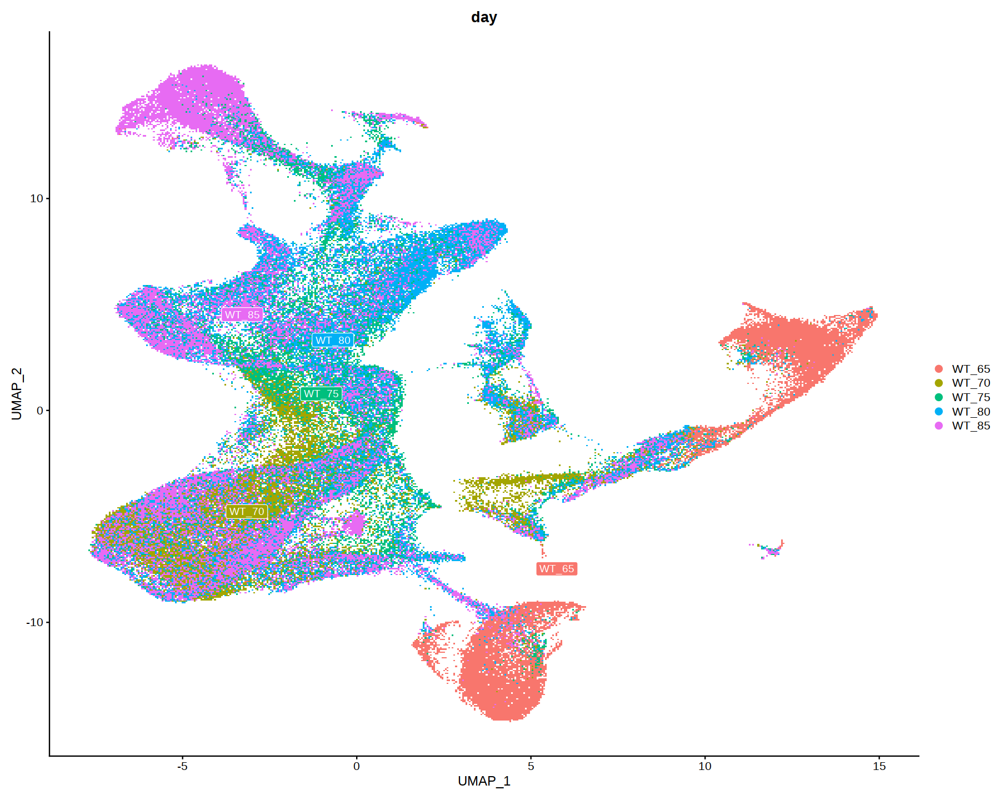

In [10]:
p1 <- DimPlot(combined, reduction = "umap", group.by = 'day',label = T, repel = T, label.box = T, label.color = "white")
options(repr.plot.width = 15, repr.plot.height = 12)
p1 

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



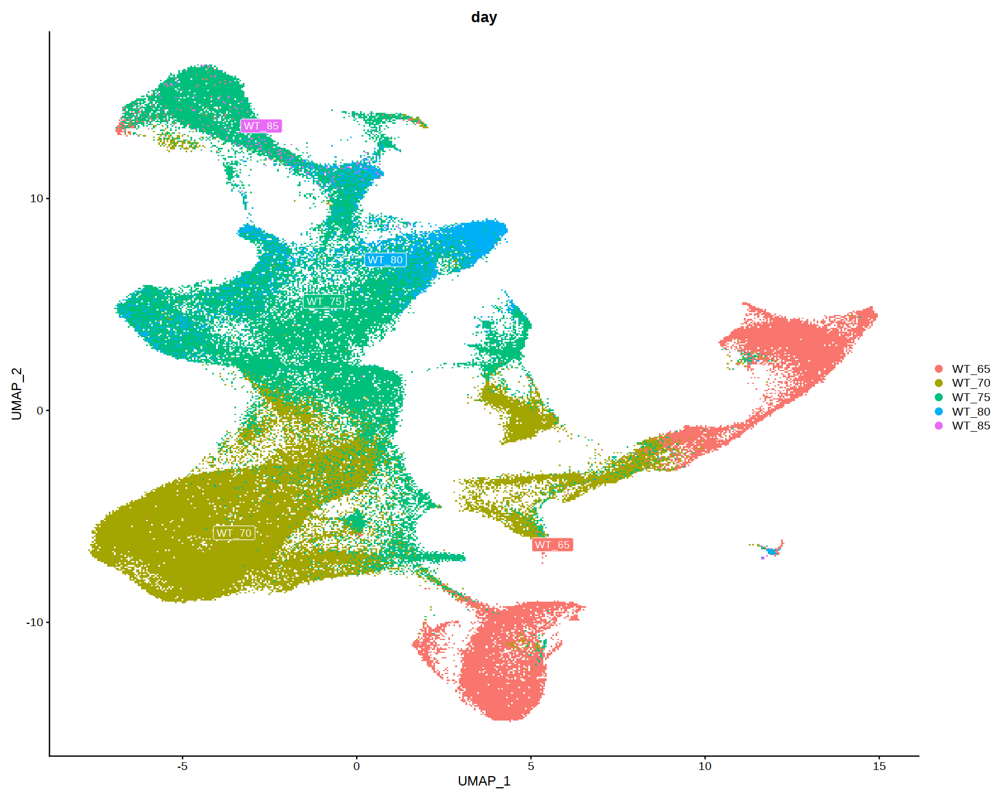

In [21]:
p1 <- DimPlot(combined, reduction = "umap", group.by = 'day',label = T, repel = T, label.box = T, label.color = "white")
options(repr.plot.width = 15, repr.plot.height = 12)
p1 

In [68]:
cc <- combined@meta.data

In [26]:
keep <- c('origin', 'day')
combined@meta.data <- combined@meta.data[,keep]
combined@meta.data

,origin,day
,<chr>,<chr>
cell_1_1,E6.5,WT_70
cell_2_1,E6.5,WT_75
cell_3_1,E6.5,WT_65
cell_4_1,E6.5,WT_70
cell_5_1,E6.5,WT_65
cell_6_1,E6.5,WT_70
cell_7_1,E6.5,WT_70
cell_8_1,E6.5,WT_70
cell_9_1,E6.5,WT_70


In [43]:
combined@meta.data <- combined@meta.data %>% 
  mutate(origin = str_replace(origin, "Emb6 ", " E6.5"))
combined@meta.data <- combined@meta.data %>% 
  mutate(origin = str_replace(origin, "Emb_7 ", " E7.0"))
combined@meta.data <- combined@meta.data %>% 
  mutate(origin = str_replace(origin, "Emb_7.5 ", " E7.5"))
combined@meta.data <- combined@meta.data %>% 
  mutate(origin = str_replace(origin, "Emb75b ", " E7.5"))
combined@meta.data <- combined@meta.data %>% 
  mutate(origin = str_replace(origin, "Emb8 ", " E8.0"))
combined@meta.data <- combined@meta.data %>% 
  mutate(origin = str_replace(origin, "Emb8.5 ", " E8.5"))
combined <- SetIdent(combined, value = combined@meta.data$origin)
levels(combined)

[1] " E6.5" " E7.0" " E7.5" " E8.0" " E8.5"

In [44]:
keep <- c('origin', 'day')
comp <- combined@meta.data[,keep]
comp

,origin,day
,<chr>,<chr>
cell_1_1,E6.5,WT_70
cell_2_1,E6.5,WT_70
cell_3_1,E6.5,WT_65
cell_4_1,E6.5,WT_70
cell_5_1,E6.5,WT_65
cell_6_1,E6.5,WT_70
cell_7_1,E6.5,WT_70
cell_8_1,E6.5,WT_70
cell_9_1,E6.5,WT_70


In [73]:
unique(comp$origin)

[1] " E6.5" " E7.0" " E7.5" " E8.0" " E8.5"

In [45]:
freq <- table(comp$origin, comp$day)
freq_df <- as.data.frame(freq)
freq_df

Var1,Var2,Freq
<fct>,<fct>,<int>
E6.5,WT_65,1895
E7.0,WT_65,6250
E7.5,WT_65,8169
E8.0,WT_65,4569
E8.5,WT_65,1676
E6.5,WT_70,3328
E7.0,WT_70,17095
E7.5,WT_70,8112
E8.0,WT_70,1166


In [81]:
write.csv(freq_df, 'timepoints.csv')

In [46]:
links <- freq_df

In [47]:
nodes <- data.frame(
  name=c(as.character(comp$origin), 
  as.character(comp$day)) %>% unique()
)

In [48]:
links$IDsource <- match(links$Var1, nodes$name)-1 
links$IDtarget <- match(links$Var2, nodes$name)-1

In [49]:
library(networkD3)
p <- sankeyNetwork(Links = links, Nodes = nodes,
              Source = "IDsource", Target = "IDtarget",
              Value = "Freq", NodeID = "name", 
              fontSize = 32, nodeWidth = 40, nodePadding = 25)

In [50]:
library(htmlwidgets)
p
saveWidget(p, file="sample4.html")

HTML widgets cannot be represented in plain text (need html)

## Fold change between classifiers

In [5]:
combined@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,RNA_snn_res.0.5,seurat_clusters,Dataset,Day,Replicate,Stage,Epithelialized,integrated_snn_res.0.5,celltype,Emb_Stage,max,cluster,Emb_Stage_1,siml,celltype_1
,<chr>,<dbl>,<int>,<dbl>,<chr>,<fct>,<chr>,<int>,<int>,<chr>,<chr>,<fct>,<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>,<fct>
AAACCTGAGCGAAGGG-1_1,Emb8,12218,3257,0,0,6,NA,NA,NA,NA,NA,6,Intermediate mesoderm,E8.25,0.8397238,12,WT_80,0.8431902,posterior lateral plate mesoderm
AAACCTGAGCGTTTAC-1_1,Emb8,18835,4307,0,11,11,NA,NA,NA,NA,NA,11,Surface ectoderm,E7.75,0.8634878,10,WT_80,0.8851594,preplacodal ectoderm
AAACCTGAGGCCCTCA-1_1,Emb8,19419,3554,0,1,13,NA,NA,NA,NA,NA,13,Erythroid1,E7.75,0.8792581,9,WT_80,0.9088349,primitive blood early
AAACCTGAGGGTGTGT-1_1,Emb8,33041,5334,0,0,6,NA,NA,NA,NA,NA,6,Pre-somitic mesoderm,E8.25,0.8914452,30,WT_80,0.8938382,presomitic mesoderm
AAACCTGCAATTCCTT-1_1,Emb8,20536,4166,0,0,6,NA,NA,NA,NA,NA,6,Pre-somitic mesoderm,E8.25,0.8904928,2,WT_80,0.8980473,primitive streak late
AAACCTGCATATGGTC-1_1,Emb8,17420,3901,0,20,24,NA,NA,NA,NA,NA,24,Parietal endoderm,E8.0,0.8640184,14,WT_80,0.8863644,parietal endoderm
AAACCTGCATCTCCCA-1_1,Emb8,19650,3620,0,1,13,NA,NA,NA,NA,NA,13,Erythroid2,E8.25,0.9015643,9,WT_80,0.9188597,primitive blood early
AAACCTGCATGACATC-1_1,Emb8,15332,3831,0,12,8,NA,NA,NA,NA,NA,8,Gut,E7.75,0.8366688,7,WT_75,0.8220033,gut
AAACCTGCATGCCACG-1_1,Emb8,13697,3664,0,5,7,NA,NA,NA,NA,NA,7,NMP,E8.25,0.8571195,31,WT_80,0.8616283,neuromesod. progen. late


# Stacked barplot analysis

In [6]:
conditions <- SetIdent(combined, value = combined@meta.data$orig.ident)

In [7]:
levels(conditions)

[1] "Emb8"             "tls3"             "gast"             "tlscl"           
 [5] "Emb8.5"           "Embryoid"         "TLS_108h"         "Gast_96h"        
 [9] "Emb_7"            "Emb_7.5"          "EpiTS_Day5_ep"    "EpiTS_Day6_ep"   
[13] "EpiTS_Day7_ep"    "EpiTS_Day8_ep"    "EpiTS_Day5_nonep" "EpiTS_Day6_nonep"
[17] "EpiTS_Day7_nonep" "EpiTS_Day8_nep"   "Gas_Lut_Day4"     "Gas_Lut_Day5"    
[21] "Gas_Lut_Day6"     "Gas_Lut_Day7"     "Emb6"

In [8]:
Emb8 <- subset(conditions, idents = ('Emb8'))
Emb85 <- subset(conditions, idents = ('Emb8.5'))
Emb75 <- subset(conditions, idents = ('Emb_7.5'))
Emb7 <- subset(conditions, idents = ('Emb_7'))
Thi <- subset(conditions, idents = ('Embryoid'))
epi5 <- subset(conditions, idents = ('EpiTS_Day5_nonep'))
epi5e <- subset(conditions, idents = ('EpiTS_Day5_ep'))
tls2 <- subset(conditions, idents = ('TLS_108h'))
lut4 <- subset(conditions, idents = ('Gas_Lut_Day4'))
gast96 <- subset(conditions, idents = ('Gast_96h'))
tlscl <- subset(conditions, idents = ('tlscl'))
Emb8 <- tibble::rownames_to_column(Emb8@meta.data, "Cell")
Emb85 <- tibble::rownames_to_column(Emb85@meta.data, "Cell")
Emb75 <- tibble::rownames_to_column(Emb75@meta.data, "Cell")
Emb7 <- tibble::rownames_to_column(Emb7@meta.data, "Cell")
Thi <- tibble::rownames_to_column(Thi@meta.data, "Cell")
epi5 <- tibble::rownames_to_column(epi5@meta.data, "Cell")
epi5e <- tibble::rownames_to_column(epi5e@meta.data, "Cell")
tls2 <- tibble::rownames_to_column(tls2@meta.data, "Cell")
lut4 <- tibble::rownames_to_column(lut4@meta.data, "Cell")
gast96 <- tibble::rownames_to_column(gast96@meta.data, "Cell")
tlscl <- tibble::rownames_to_column(tlscl@meta.data, "Cell")

In [9]:
Emb8

Cell,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,RNA_snn_res.0.5,seurat_clusters,Dataset,Day,Replicate,Stage,Epithelialized,integrated_snn_res.0.5,celltype,Emb_Stage,max,cluster,Emb_Stage_1,siml,celltype_1
<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>,<fct>,<chr>,<int>,<int>,<chr>,<chr>,<fct>,<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>,<fct>
AAACCTGAGCGAAGGG-1_1,Emb8,12218,3257,0,0,6,NA,NA,NA,NA,NA,6,Intermediate mesoderm,E8.25,0.8397238,12,WT_80,0.8431902,posterior lateral plate mesoderm
AAACCTGAGCGTTTAC-1_1,Emb8,18835,4307,0,11,11,NA,NA,NA,NA,NA,11,Surface ectoderm,E7.75,0.8634878,10,WT_80,0.8851594,preplacodal ectoderm
AAACCTGAGGCCCTCA-1_1,Emb8,19419,3554,0,1,13,NA,NA,NA,NA,NA,13,Erythroid1,E7.75,0.8792581,9,WT_80,0.9088349,primitive blood early
AAACCTGAGGGTGTGT-1_1,Emb8,33041,5334,0,0,6,NA,NA,NA,NA,NA,6,Pre-somitic mesoderm,E8.25,0.8914452,30,WT_80,0.8938382,presomitic mesoderm
AAACCTGCAATTCCTT-1_1,Emb8,20536,4166,0,0,6,NA,NA,NA,NA,NA,6,Pre-somitic mesoderm,E8.25,0.8904928,2,WT_80,0.8980473,primitive streak late
AAACCTGCATATGGTC-1_1,Emb8,17420,3901,0,20,24,NA,NA,NA,NA,NA,24,Parietal endoderm,E8.0,0.8640184,14,WT_80,0.8863644,parietal endoderm
AAACCTGCATCTCCCA-1_1,Emb8,19650,3620,0,1,13,NA,NA,NA,NA,NA,13,Erythroid2,E8.25,0.9015643,9,WT_80,0.9188597,primitive blood early
AAACCTGCATGACATC-1_1,Emb8,15332,3831,0,12,8,NA,NA,NA,NA,NA,8,Gut,E7.75,0.8366688,7,WT_75,0.8220033,gut
AAACCTGCATGCCACG-1_1,Emb8,13697,3664,0,5,7,NA,NA,NA,NA,NA,7,NMP,E8.25,0.8571195,31,WT_80,0.8616283,neuromesod. progen. late


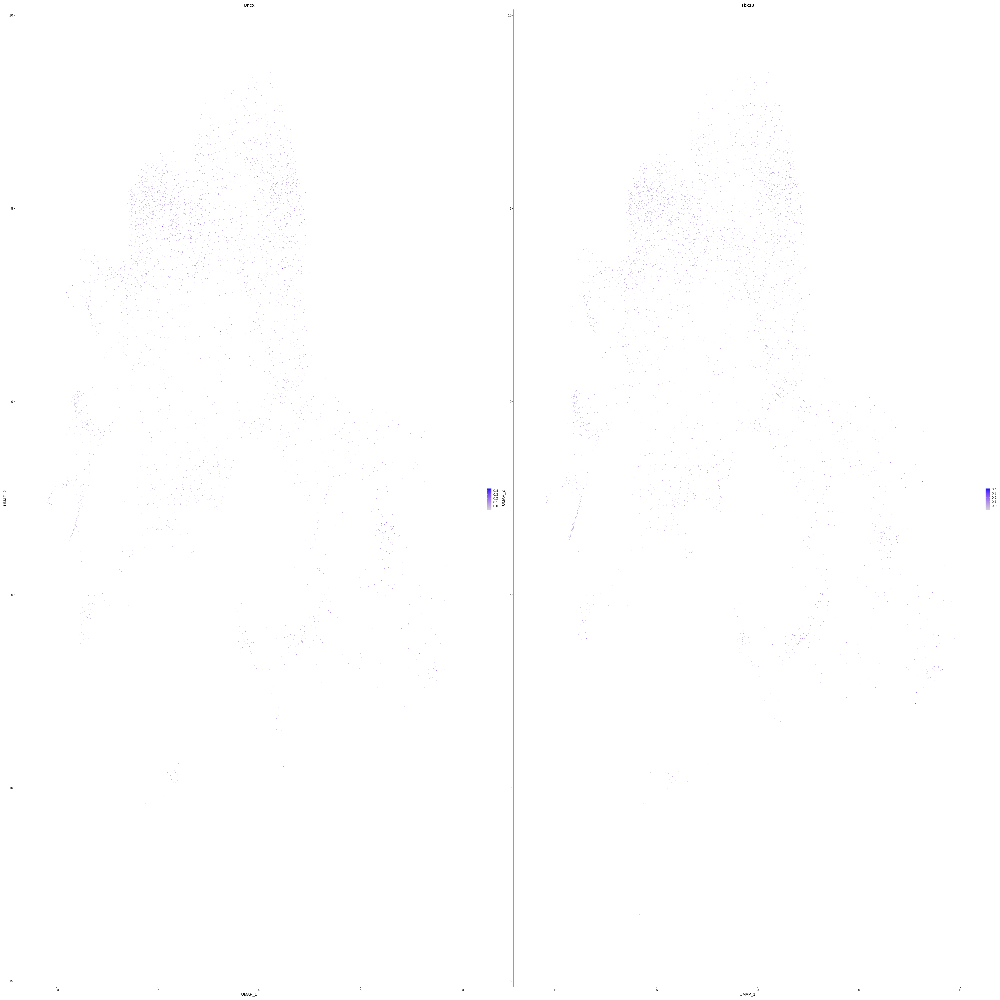

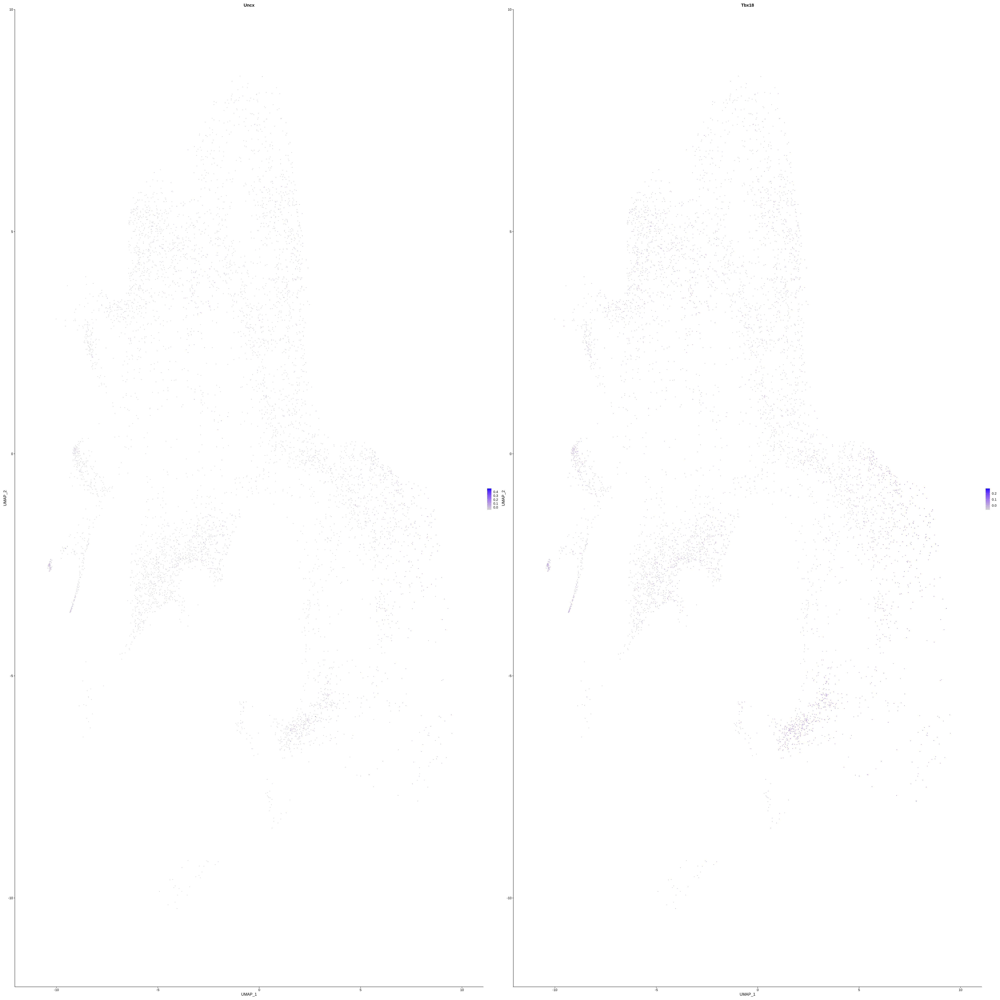

In [54]:
epi5 <- subset(conditions, idents = ('EpiTS_Day5_nonep'))
epi5e <- subset(conditions, idents = ('EpiTS_Day5_ep'))
FeaturePlot(epi5e, features = c("Uncx", "Tbx18"))
FeaturePlot(epi5, features = c("Uncx", "Tbx18"))           

In [6]:
lib24 <- subset(conditions, idents = ('24_h_gast'))
lib36 <- subset(conditions, idents = ('36_h_gast'))
lib48 <- subset(conditions, idents = ('48_h_gast'))
lib60 <- subset(conditions, idents = ('60_h_gast'))
lib72 <- subset(conditions, idents = ('72_h_gast'))
lib84a <- subset(conditions, idents = ('84_h_gast_a'))
lib84b <- subset(conditions, idents = ('84_h_gast_b'))

In [7]:
lib24 <- tibble::rownames_to_column(lib24@meta.data, "Cell")
lib36 <- tibble::rownames_to_column(lib36@meta.data, "Cell")
lib48 <- tibble::rownames_to_column(lib48@meta.data, "Cell")
lib60 <- tibble::rownames_to_column(lib60@meta.data, "Cell")
lib72 <- tibble::rownames_to_column(lib72@meta.data, "Cell")
lib84a <- tibble::rownames_to_column(lib84a@meta.data, "Cell")
lib84b <- tibble::rownames_to_column(lib84b@meta.data, "Cell")

In [41]:
combined@meta.data$Emb_Stage_1 <- unlist(combined@meta.data$Emb_Stage_1)

In [7]:
#celltype
n_Cell <- length(unique(Emb8$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p1 <- ggplot(as.data.frame(Emb8),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "bottom") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(Emb85$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p2 <- ggplot(as.data.frame(Emb85),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8.5") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(Emb75$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p3 <- ggplot(as.data.frame(Emb75),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E7.5") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(Emb7$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p4 <- ggplot(as.data.frame(Emb7),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E7") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(Thi$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p5 <- ggplot(as.data.frame(Thi),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Embryoid") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(epi5$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p6 <- ggplot(as.data.frame(epi5),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 control") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(epi5e$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p7 <- ggplot(as.data.frame(epi5e),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 epithelialised") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(tls2$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p8 <- ggplot(as.data.frame(tls2),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("TLS_108h") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(lut4$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p9 <- ggplot(as.data.frame(lut4),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Lutolf Gast D4") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(gast96$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p10 <- ggplot(as.data.frame(gast96),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Stembryo Gast 96h") + scale_color_brewer(palette = "Dark2")
n_Cell <- length(unique(tlscl$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p11 <- ggplot(as.data.frame(tlscl),
      aes(x = orig.ident, stratum = celltype_1, alluvium = Cell, fill = celltype_1, label = celltype_1)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("TLSCL") 

Warning message:
“Removed 1 rows containing missing values (geom_text).”


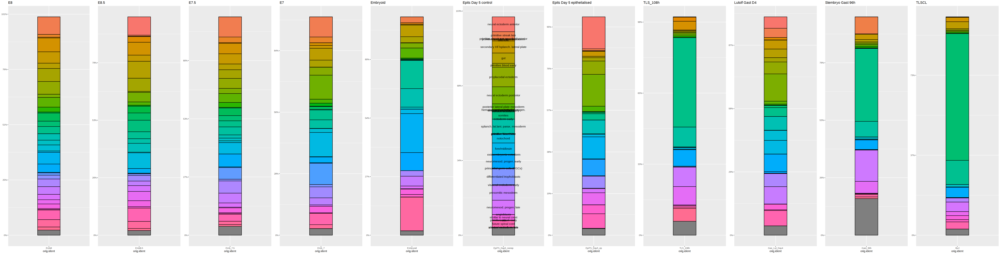

In [85]:
options(repr.plot.width = 55, repr.plot.height = 14)
ggarrange(p1, p2, p3, p4, p5, p6, p7, p8, p9, p10, p11,
          ncol = 11, nrow = 1)

Warning message:
“Removed 1 rows containing missing values (geom_text).”


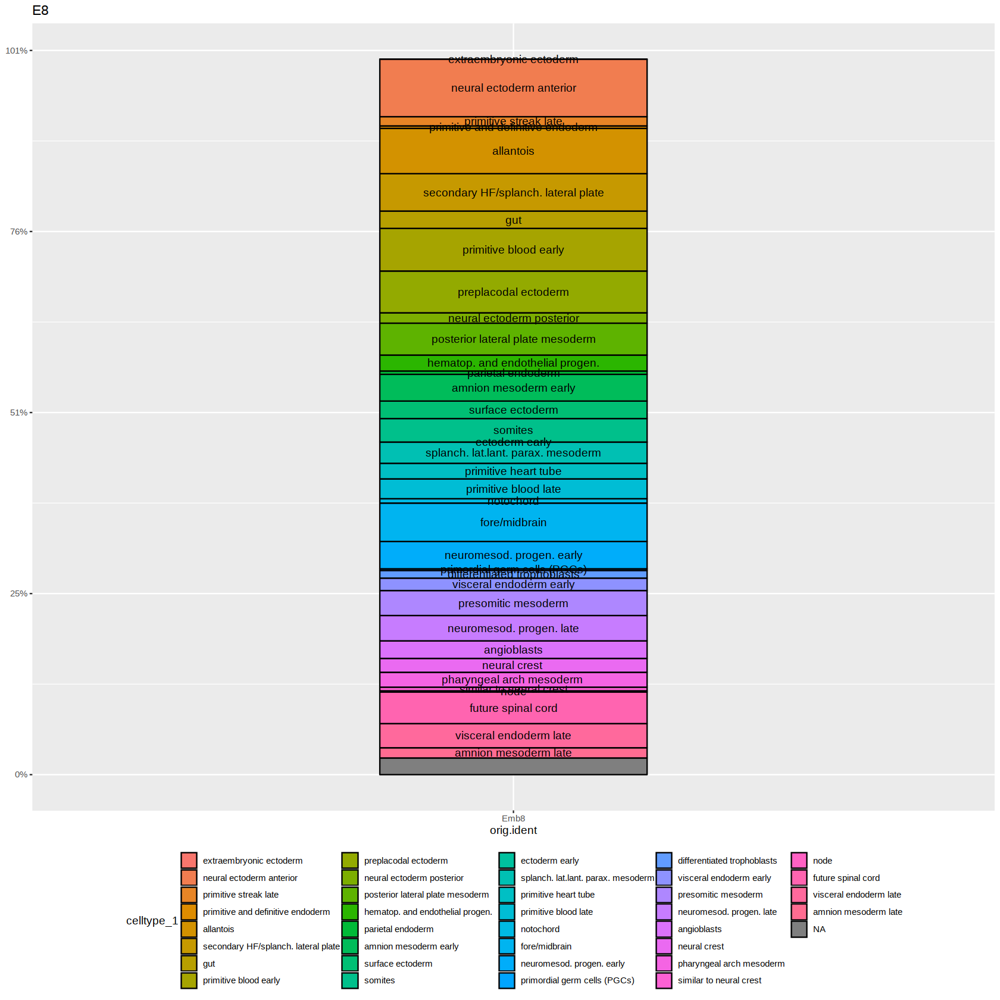

In [10]:
options(repr.plot.width = 14, repr.plot.height = 14)
p1

Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”


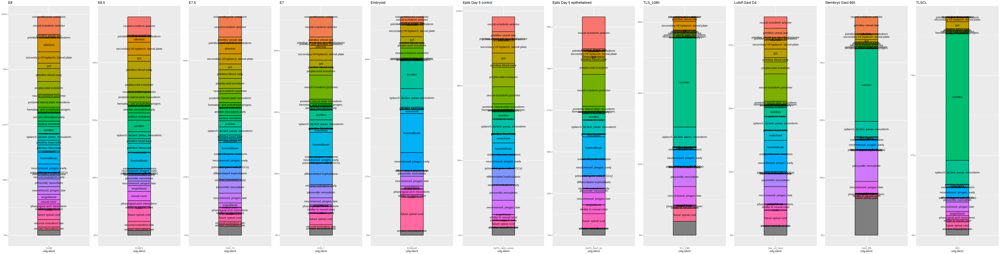

In [80]:
options(repr.plot.width = 55, repr.plot.height = 14)
ggarrange(p1, p2, p3, p4, p5, p6, p7, p8, p9, p10, p11,
          ncol = 11, nrow = 1)

Warning message:
“Removed 1 rows containing missing values (geom_text).”
Warning message:
“Removed 1 rows containing missing values (geom_text).”


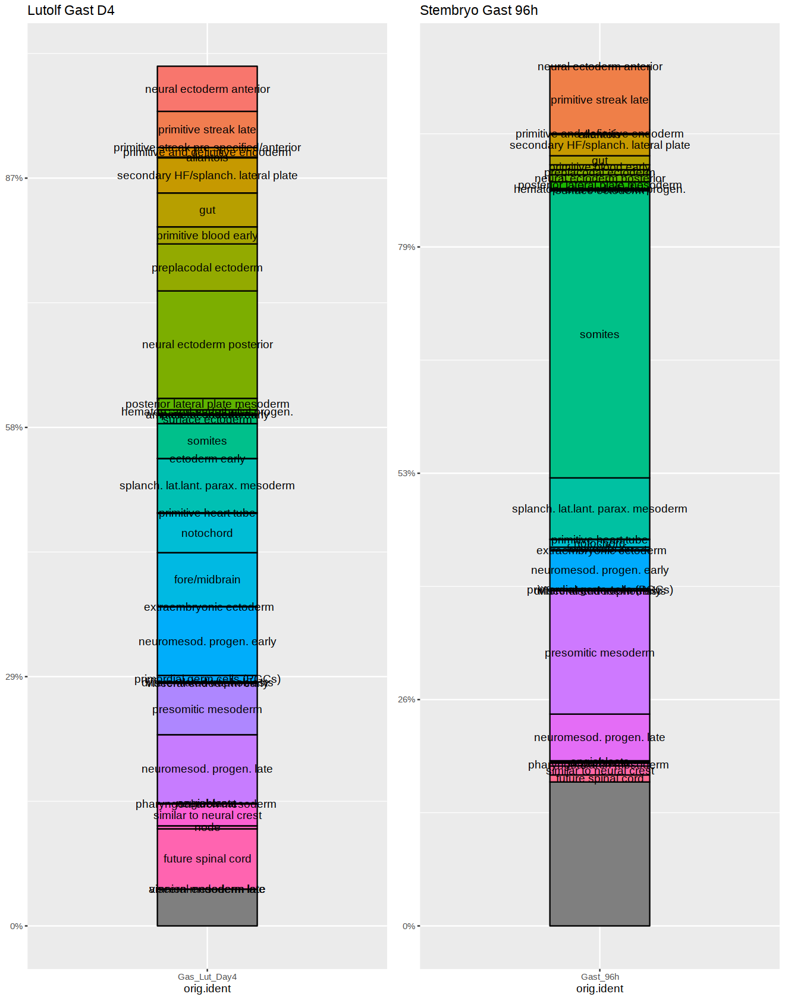

In [81]:
options(repr.plot.width = 11, repr.plot.height = 14)
ggarrange(p9, p10,
          ncol = 2, nrow = 1)

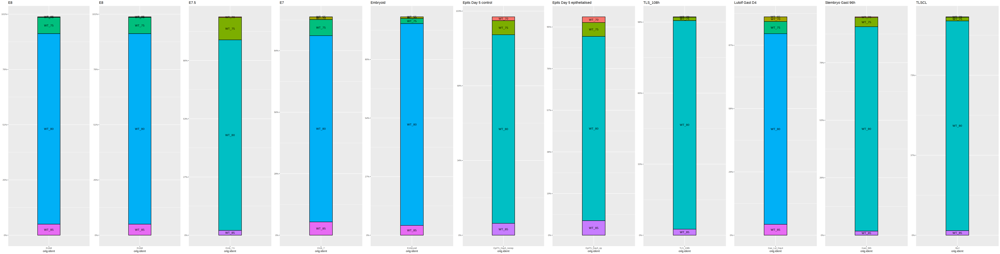

In [76]:
options(repr.plot.width = 55, repr.plot.height = 14)
ggarrange(p1, p1, p3, p4, p5, p6, p7, p8, p9, p10, p11,
          ncol = 11, nrow = 1)

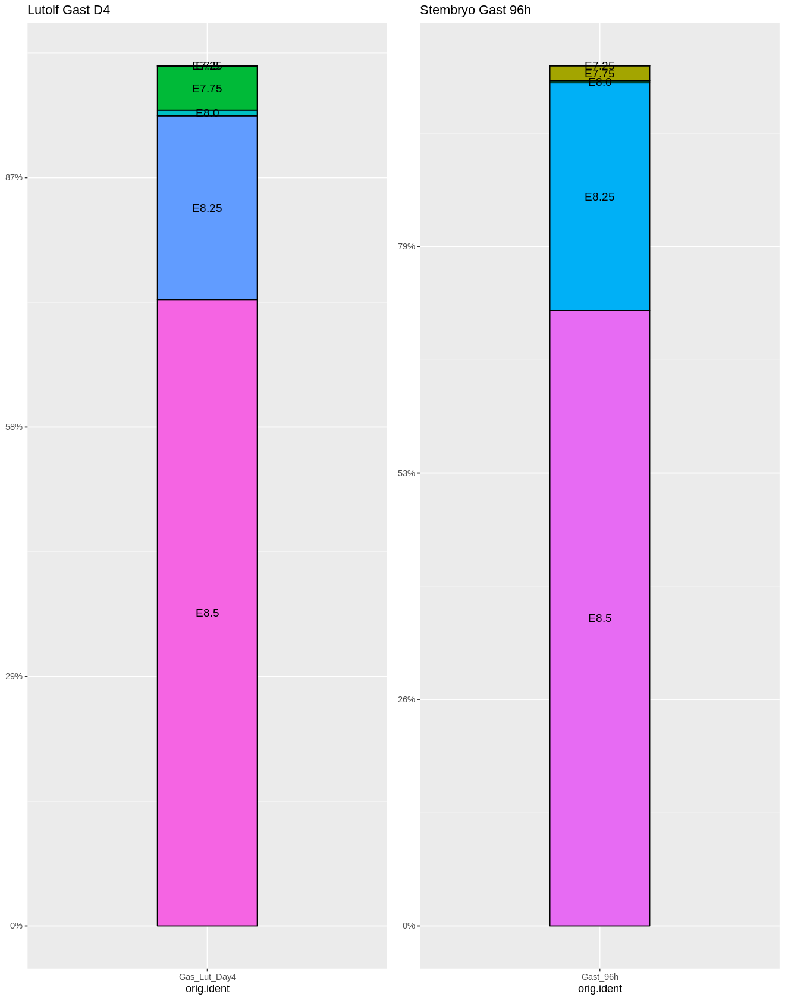

In [26]:
options(repr.plot.width = 11, repr.plot.height = 14)
ggarrange(p9, p10,
          ncol = 2, nrow = 1)

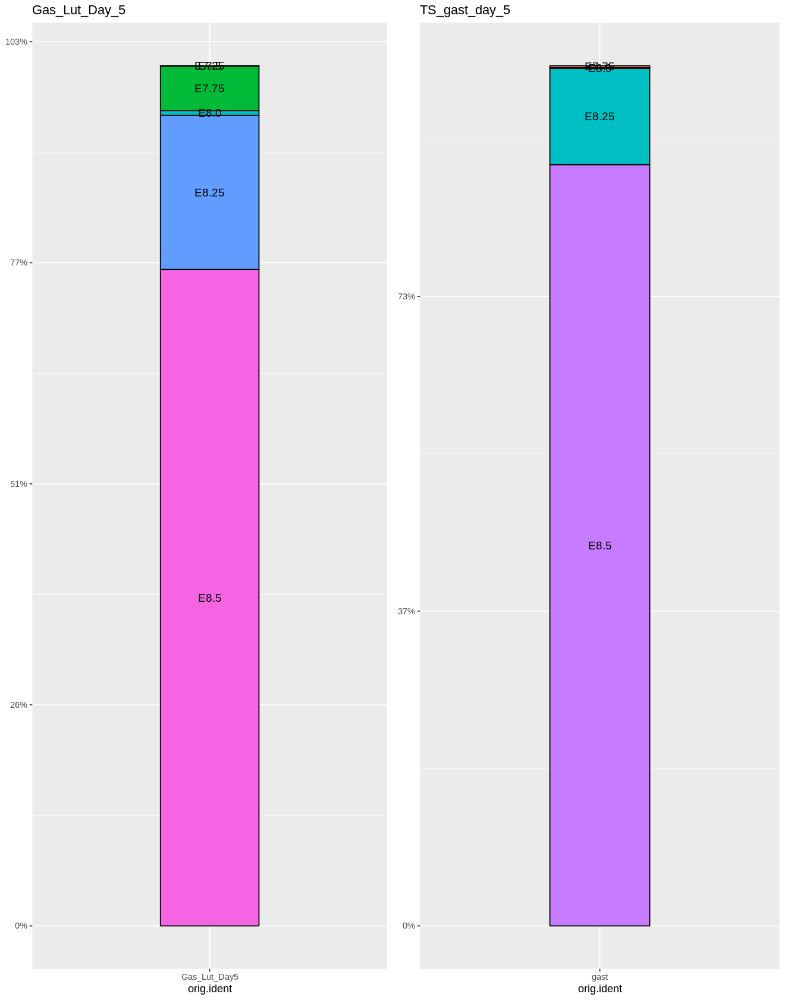

In [32]:
n_Cell <- length(unique(lut5$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p1 <- ggplot(as.data.frame(lut5),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Gas_Lut_Day_5") 
n_Cell <- length(unique(gast$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p2 <- ggplot(as.data.frame(gast),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("TS_gast_day_5")
options(repr.plot.width = 11, repr.plot.height = 14)
ggarrange(p1, p2,
          ncol = 2, nrow = 1)

In [24]:
n_Cell <- length(unique(Emb8$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p1 <- ggplot(as.data.frame(Emb8),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8") 
n_Cell <- length(unique(Emb85$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p2 <- ggplot(as.data.frame(Emb85),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8.5") 
n_Cell <- length(unique(Emb75$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p3 <- ggplot(as.data.frame(Emb75),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E7.5") 
n_Cell <- length(unique(Emb7$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p4 <- ggplot(as.data.frame(Emb7),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E7") 
n_Cell <- length(unique(Thi$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p5 <- ggplot(as.data.frame(Thi),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Embryoid") 
n_Cell <- length(unique(epi5$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p6 <- ggplot(as.data.frame(epi5),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 control") 
n_Cell <- length(unique(epi5e$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p7 <- ggplot(as.data.frame(epi5e),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 epithelialised") 
n_Cell <- length(unique(tls2$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p8 <- ggplot(as.data.frame(tls2),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("TLS_108h") 
n_Cell <- length(unique(lut4$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p9 <- ggplot(as.data.frame(lut4),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Lutolf Gast D4") 
n_Cell <- length(unique(gast96$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p10 <- ggplot(as.data.frame(gast96),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Stembryo Gast 96h") 
n_Cell <- length(unique(tlscl$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p11 <- ggplot(as.data.frame(tlscl),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("TLSCL") 

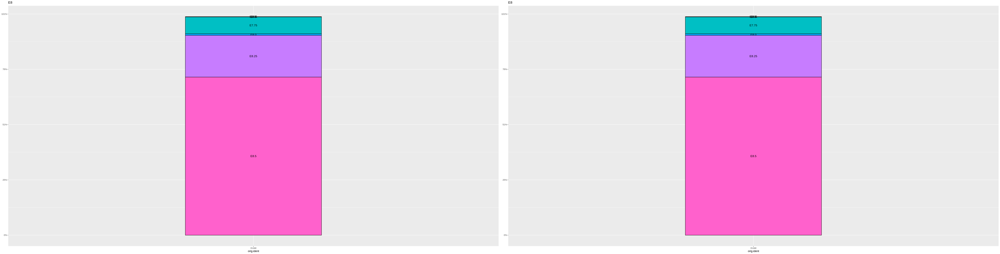

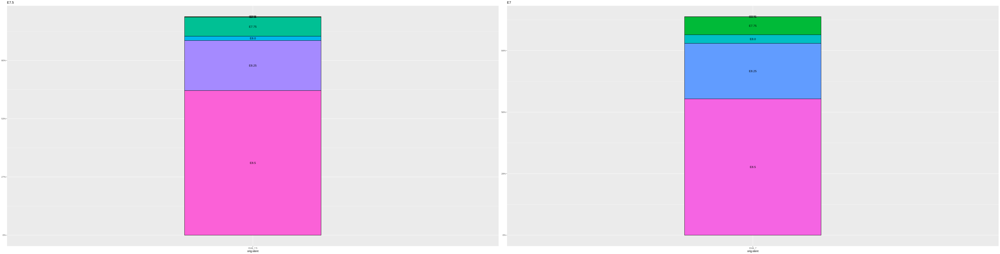

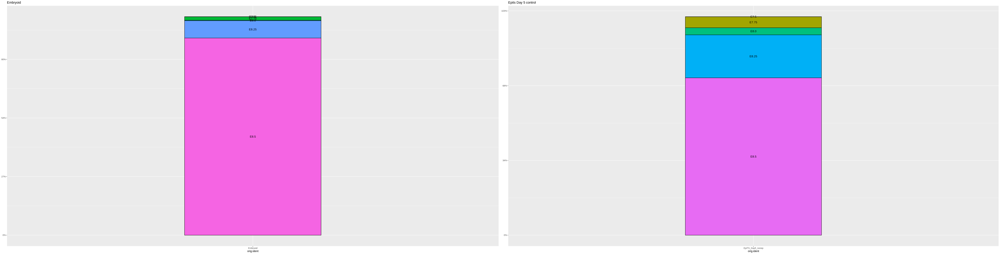

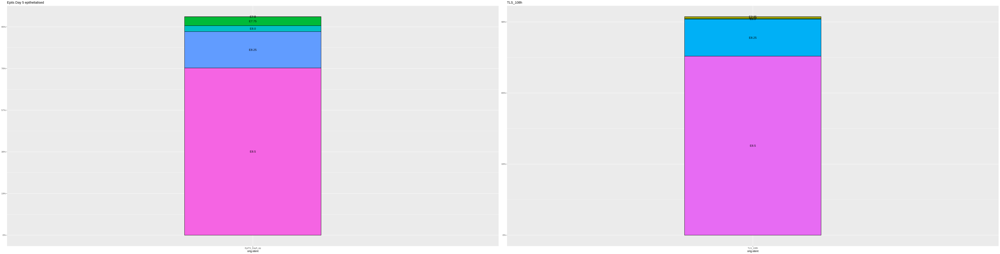

$`1`

$`2`

$`3`

$`4`

$`5`

$`6`

attr(,"class")
[1] "list"      "ggarrange"

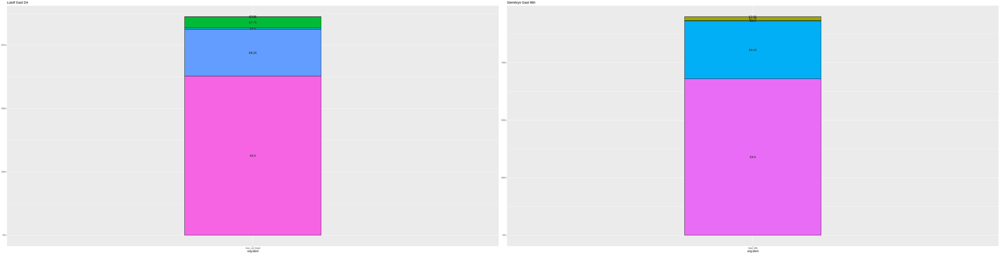

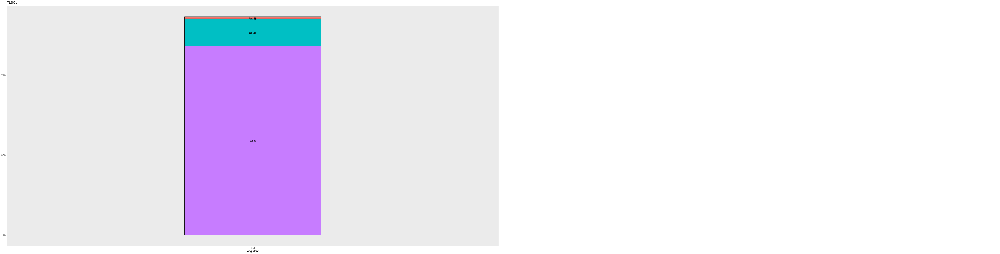

In [25]:
options(repr.plot.width = 55, repr.plot.height = 14)
ggarrange(p1, p1, p3, p4, p5, p6, p7, p8, p9, p10, p11,
          ncol = 2, nrow = 1)

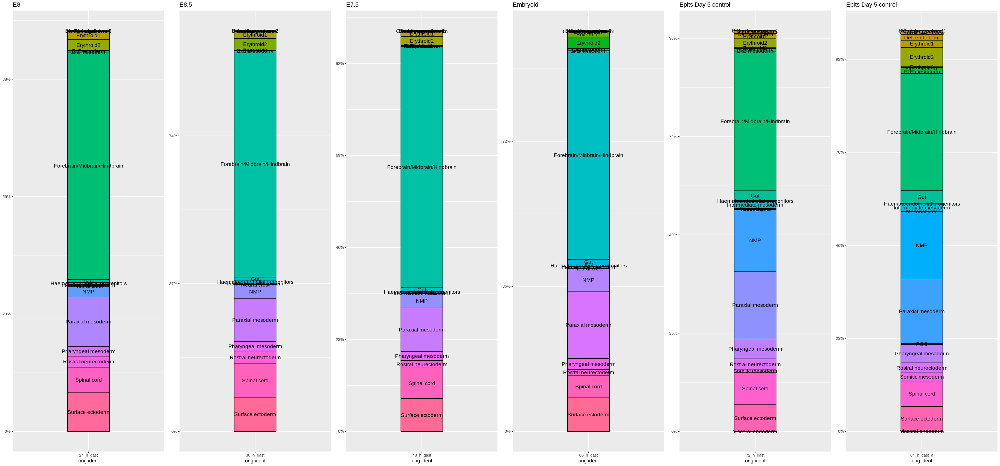

In [58]:
n_Cell <- length(unique(lib24$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p1 <- ggplot(as.data.frame(lib24),
      aes(x = orig.ident, stratum = celltype, alluvium = Cell, fill = celltype, label = celltype)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8") 
n_Cell <- length(unique(lib36$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p2 <- ggplot(as.data.frame(lib36),
      aes(x = orig.ident, stratum = celltype, alluvium = Cell, fill = celltype, label = celltype)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8.5") 
n_Cell <- length(unique(lib48$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p3 <- ggplot(as.data.frame(lib48),
      aes(x = orig.ident, stratum = celltype, alluvium = Cell, fill = celltype, label = celltype)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E7.5") 
n_Cell <- length(unique(lib60$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p4 <- ggplot(as.data.frame(lib60),
      aes(x = orig.ident, stratum = celltype, alluvium = Cell, fill = celltype, label = celltype)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Embryoid") 
n_Cell <- length(unique(lib72$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p5 <- ggplot(as.data.frame(lib72),
      aes(x = orig.ident, stratum = celltype, alluvium = Cell, fill = celltype, label = celltype)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 control") 
n_Cell <- length(unique(lib84a$Cell))
p6 <- ggplot(as.data.frame(lib84a),
      aes(x = orig.ident, stratum = celltype, alluvium = Cell, fill = celltype, label = celltype)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 control")
options(repr.plot.width = 30, repr.plot.height = 14)
ggarrange(p1, p2,p3,p4,p5,p6,
          ncol = 6, nrow = 1)

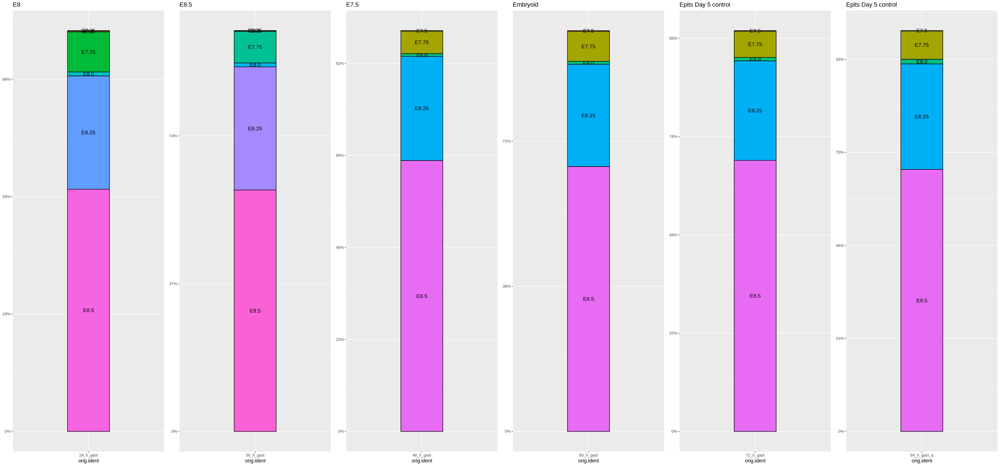

In [59]:
n_Cell <- length(unique(lib24$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p1 <- ggplot(as.data.frame(lib24),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8") 
n_Cell <- length(unique(lib36$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p2 <- ggplot(as.data.frame(lib36),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E8.5") 
n_Cell <- length(unique(lib48$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p3 <- ggplot(as.data.frame(lib48),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("E7.5") 
n_Cell <- length(unique(lib60$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p4 <- ggplot(as.data.frame(lib60),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Embryoid") 
n_Cell <- length(unique(lib72$Cell))
options(repr.plot.width = 5, repr.plot.height = 14)
p5 <- ggplot(as.data.frame(lib72),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 control") 
n_Cell <- length(unique(lib84a$Cell))
p6 <- ggplot(as.data.frame(lib84a),
      aes(x = orig.ident, stratum = Emb_Stage, alluvium = Cell, fill = Emb_Stage, label = Emb_Stage)) +
      geom_flow(stat = "alluvium", lode.guidance = "frontback") +
      geom_stratum() +
      theme(legend.position = "none") +
      geom_text(stat = "stratum", size = 4) +
      scale_y_continuous(label = scales::percent_format(scale = 100 / n_Cell)) +
      ggtitle("Epits Day 5 control")
options(repr.plot.width = 30, repr.plot.height = 14)
ggarrange(p1, p2,p3,p4,p5,p6,
          ncol = 6, nrow = 1)

In [61]:
lib24 <- subset(conditions, idents = ('24_h_gast'))
lib1 <- SetIdent(lib24, value = lib24@meta.data$celltype)
levels(lib1)

[1] "Erythroid1"                     "Surface ectoderm"              
 [3] "Forebrain/Midbrain/Hindbrain"   "Erythroid2"                    
 [5] "Rostral neurectoderm"           "Paraxial mesoderm"             
 [7] "NMP"                            "Spinal cord"                   
 [9] "Haematoendothelial progenitors" "Pharyngeal mesoderm"           
[11] "Neural crest"                   "ExE ectoderm"                  
[13] "Gut"                            "Blood progenitors 2"           
[15] "Endothelium"                    "Intermediate mesoderm"         
[17] "Blood progenitors 1"            "ExE mesoderm"

In [62]:
clu <- FindMarkers(combined, ident.1 = 'Forebrain/Midbrain/Hindbrain', only.pos = TRUE, pseudocount.use = 0.1)
clu

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Trh,0,0.5707218,0.635,0.542,0
Crabp1,0,0.7300166,0.974,0.946,0
Tmsb4x,0,0.4554213,1.000,0.995,0
Crabp2,0,0.6626314,0.996,0.952,0
Pou5f1,0,0.3236680,0.628,0.507,0
Onecut2,0,1.0561712,0.736,0.602,0
Nefl,0,0.6978986,0.736,0.665,0
Nkx2-9,0,0.9886234,0.924,0.826,0
Pim2,0,0.8380952,0.703,0.586,0


In [63]:
clu <- FindMarkers(lib1, ident.1 = 'Forebrain/Midbrain/Hindbrain', only.pos = TRUE, pseudocount.use = 0.1)
clu

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Sox1,2.366986e-171,0.3025653,1.000,0.997,4.733973e-168
Pax6,8.113031e-168,0.4565228,1.000,0.972,1.622606e-164
Lhx5,2.809587e-149,0.3348064,0.999,1.000,5.619175e-146
Mir124-2hg,4.129850e-148,0.2619492,1.000,0.997,8.259700e-145
Lmo1,1.076069e-145,0.3348393,0.998,0.982,2.152137e-142
Zbtb16,1.963508e-145,0.2753320,1.000,1.000,3.927015e-142
Sfrp1,6.532546e-142,0.5051159,1.000,0.986,1.306509e-138
Ptn,1.083720e-132,0.5249865,1.000,1.000,2.167440e-129
Tubb3,8.742162e-127,0.3631217,0.999,0.999,1.748432e-123


In [64]:
scmap_classifier <- readRDS(file = "scmap_classifier_1000markers.rds")
ref_stages <- c("E6.5")

In [65]:
sce <- as.SingleCellExperiment(x = lib24)
rowData(sce)$feature_symbol <- rownames(sce)
scmapCluster_results <- scmapCluster(projection = sce, index_list = scmap_classifier[ref_stages],threshold = 0)

Warning message in setFeatures(projection, rownames(index)):
“Features 0610005C13Rik, 1700001C02Rik, 1700003E16Rik, 1700007G11Rik, 1700011H14Rik, 1700012B09Rik, 1700028P14Rik, 1700088E04Rik, 2210011C24Rik, 2410004P03Rik, 3632451O06Rik, 4833427G06Rik, 4933402E13Rik, 4933434E20Rik, 6430531B16Rik, 6820408C15Rik, Abcb10, Abcg2, Abracl, AC113508.1, AC139238.1, Acaa1a, Acbd7, Acta2, Agpat4, Agtrap, Akr1b3, Akr1c13, Akr7a5, Alad, Aldh1a2, Aldh2, Aldh7a1, Aldob, Ang, Ankrd1, Ankrd66, Apoa4, Apob, Apobec3, Apoc3, Aqp3, Aqp8, Arl3, Armc2, As3mt, Asah1, Asl, Atp2a2, Atp2b1, Atp5g1, Atp6v0d1, Atp6v0e, Atp6v1a, Atp6v1d, Atp6v1e1, Atp6v1g1, Atpif1, Atraid, B9d1, Baz1a, Bex3, Bin1, Bmper, Bpgm, Bri3, Btg1, Bves, Cap2, Card19, Carhsp1, Ccdc103, Ccdc113, Ccdc146, Ccdc151, Ccdc189, Ccdc39, Ccdc65, Ccnd3, Ccpg1os, Cd151, Cdk2ap2, Cdx4, Cfap161, Cfap45, Cfap52, Cfap53, Cfap69, Cfap77, Chchd4, Chmp2a, Cib1, Ckap4, Clec1b, Clta, Cmas, Cmtm3, Cmtm7, Cndp2, Cnih2, Cnn3, Cnrip1, Commd3, Commd4, Copz2, Cox14, C

In [67]:
siml <- scmapCluster_results$scmap_cluster_siml
siml <- as.data.frame(siml)
siml[is.na(siml)] = 0
siml

E6.5
<dbl>
0.7155667
0.7800222
0.7349339
0.7616859
0.7279439
0.7469859
0.7353872
0.7573428
0.7519512


In [9]:
lib24


Cell,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,identity,RNA_snn_res.0.5,seurat_clusters,Dataset,Day,Replicate,Stage,Epithelialized,integrated_snn_res.0.5,celltype,Emb_Stage,max
<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<fct>,<chr>,<int>,<int>,<chr>,<chr>,<fct>,<chr>,<chr>,<dbl>
SBR-24h:CATTCCGCAGTTACCA_1,24_h_gast,29803.73,5888,0,SBR-24h,2,10,NA,NA,NA,NA,NA,10,Erythroid1,E7.75,0.8237718
SBR-24h:ATCCTATTCCGAGCTG_1,24_h_gast,29589.92,5471,0,SBR-24h,2,0,NA,NA,NA,NA,NA,0,Surface ectoderm,E7.75,0.9061860
SBR-24h:TCCACCACATCCTGTC_1,24_h_gast,29595.61,5776,0,SBR-24h,1,0,NA,NA,NA,NA,NA,0,Forebrain/Midbrain/Hindbrain,E8.25,0.8812011
SBR-24h:GGCAGTCAGAGCAGAA_1,24_h_gast,31562.97,5669,0,SBR-24h,1,10,NA,NA,NA,NA,NA,10,Surface ectoderm,E8.5,0.8759478
SBR-24h:TAGGAGGCAAATACGA_1,24_h_gast,30281.97,5444,0,SBR-24h,1,10,NA,NA,NA,NA,NA,10,Erythroid2,E8.25,0.8528480
SBR-24h:CTAACTTAGTCACTCA_1,24_h_gast,33348.87,5941,0,SBR-24h,2,0,NA,NA,NA,NA,NA,0,Forebrain/Midbrain/Hindbrain,E8.25,0.8955098
SBR-24h:AGACCCGCATTCTCTA_1,24_h_gast,29189.05,5708,0,SBR-24h,1,0,NA,NA,NA,NA,NA,0,Forebrain/Midbrain/Hindbrain,E8.25,0.8786594
SBR-24h:TTAGGCAAGGATTTAG_1,24_h_gast,33534.45,5642,0,SBR-24h,1,0,NA,NA,NA,NA,NA,0,Forebrain/Midbrain/Hindbrain,E8.25,0.9267495
SBR-24h:TGATTTCCAAGTGGTG_1,24_h_gast,33770.61,5619,0,SBR-24h,1,0,NA,NA,NA,NA,NA,0,Forebrain/Midbrain/Hindbrain,E8.5,0.9160749


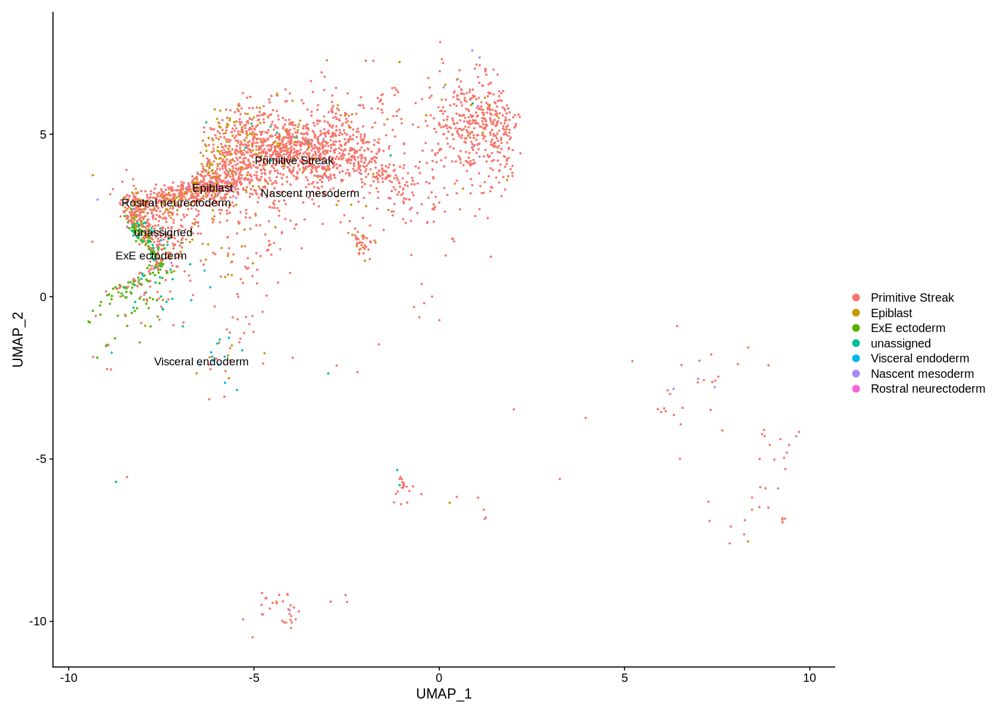

In [66]:
lib24 <- AddMetaData(object = lib24, metadata = scmapCluster_results$combined_labs, col.name = "alt_type")
Idents(lib24) <- lib24$alt_type
options(repr.plot.width = 14, repr.plot.height = 10)
DimPlot(lib24, reduction = "umap", label = T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



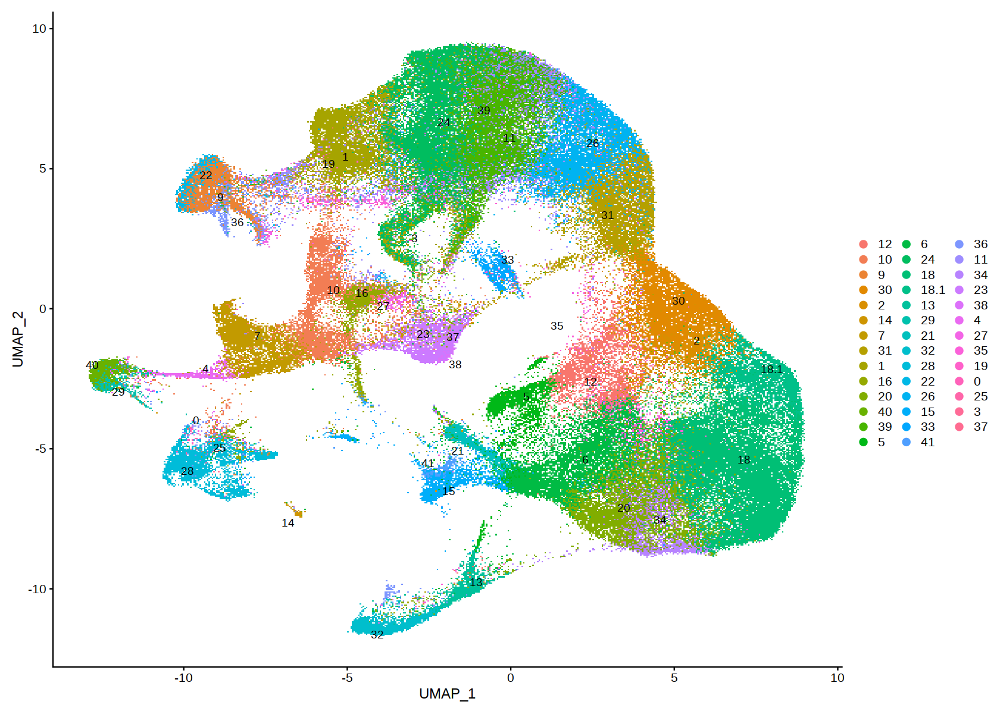

In [17]:
p1 <- DimPlot(combined, reduction = "umap", label = T, repel = T)
options(repr.plot.width = 14, repr.plot.height = 10)
p1 

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



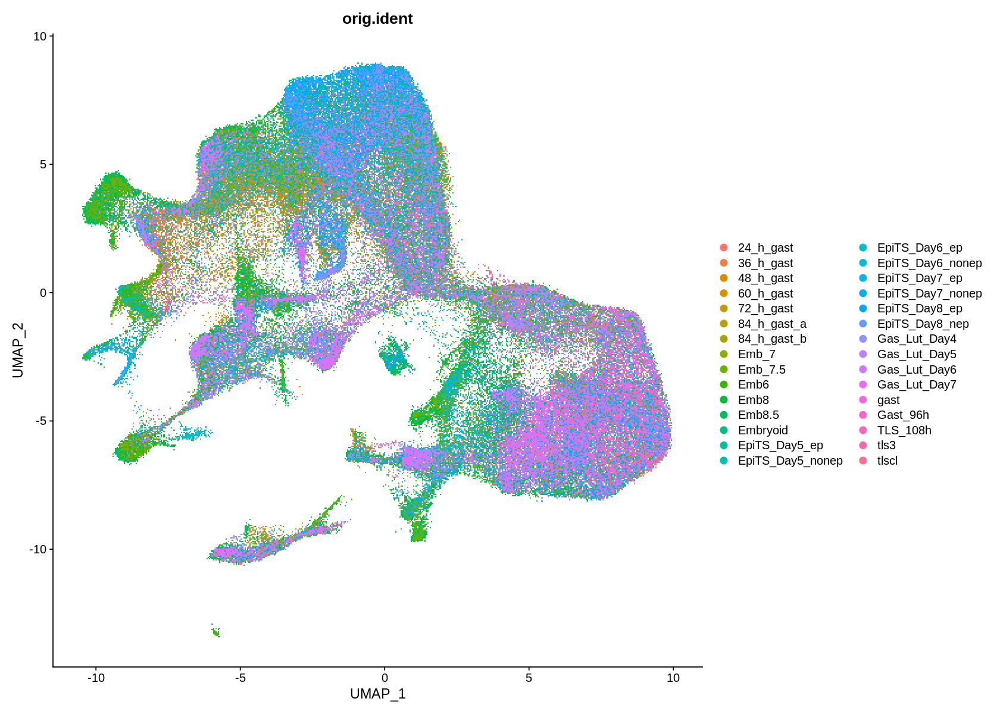

In [3]:
p2 <- DimPlot(combined, reduction = "umap", group.by = 'orig.ident')
options(repr.plot.width = 14, repr.plot.height = 10)
p2

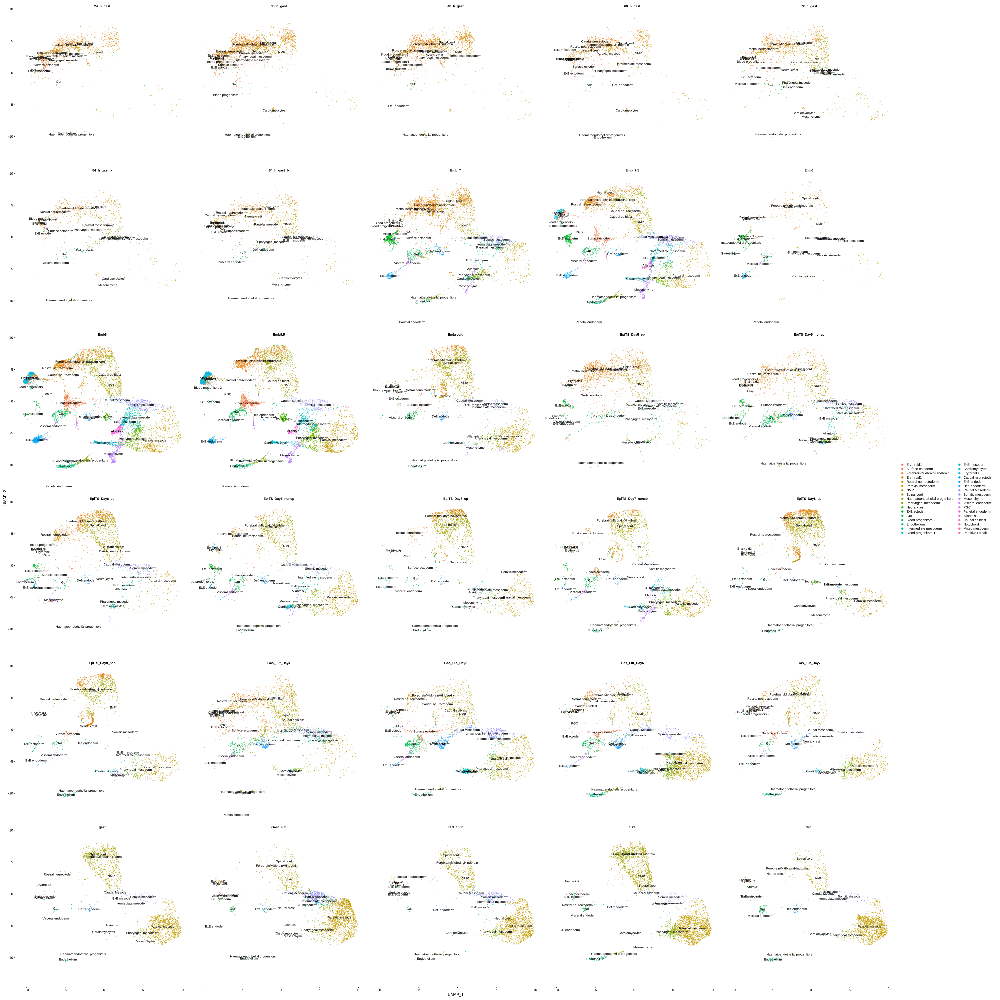

In [48]:
options(repr.plot.width = 50, repr.plot.height = 50)
DimPlot(combined, reduction = "umap", split.by = 'orig.ident', ncol = 5, raster=FALSE, label = T)

In [50]:
saveRDS(combined, 'combined_tera_annot.rds')

In [26]:
combined1 <- combined